In [259]:
#@title Requeriments
import numpy                 as np
import pandas                as pd
import matplotlib.pyplot     as plt
import seaborn               as sns
import missingno as msno

import folium  #needed for interactive map
from folium.plugins import HeatMap

import statsmodels.api         as sm
import statsmodels.formula.api as smf
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.layers import Dense, Activation
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

# Consideraciones  generales
Para una correcta participación en la competencia **Data Thriatlon** sigue este formato de notebook propuestó por el equipo de data de Platzi. Esto ayudará en la calificación de tu notebook.

Secciones del notebook:

* Extracción de datos adicionales (0-20%)
* Limpieza y transformación de datos. (0-20%)
* Analisís exploratorio (*analytics, data visualization y storytelling*). (0-60%)
* Modelo (opcional).

*Para revisar las reglas de la competencia ve a este [blogpost](https://platzi.com/blog/olimpiadas-data-triathlon/).

# ¿Qué hay en los datos?

En los datos encontrarás información de las **exportaciones e importaciones de Colombia de 1962 a 2017**. Fueron extraídos del [OEC: The Observatory of Economic Complexity](https://legacy.oec.world/en/).

Tu labor será desarrollar un análisis exploratorio para encontrar insights valiosos a partir de esos datos y otros que recopiles.



## Preguntas

Para el desarrollo de tu análisis puedes resolver las siguientes preguntas:

1. ¿Cuál es el top 10 países a los que Colombia exporta sus productos y su evolución con respecto al tiempo?
2. ¿Cuál es el top 10 países de los que Colombia importa sus productos y su evolución con respecto al tiempo?
3. ¿Existe algún producto que debido a cambios económicos en la oferta/demanda halla causado un decremento en el volumen de dinero que se mueve con él?
4. ¿Cuáles sectores económicos tienen mayor importancia en las exportaciones de Colombia y por qué?

**También puedes resolver preguntas que a ti se te ocurran.**

# Extracción de datos adicionales (0-20%)

Para extraer información adicional a la proporcionada por Platzi puedes extraerla directamente de la fuente de datos original. El dataset cuenta con la información extraída del *OEC: The Observatory of Economic Complexity*, específicamente de la versión legacy la cual permite la descarga de archivos a partir de una URL y de la API expuesta por ellos.

- [https://legacy.oec.world/en/resources/data/](https://legacy.oec.world/en/resources/data/)
- [https://legacy.oec.world/api/](https://legacy.oec.world/api/)

**Para tu análisis recolecta más datos de esta y otras fuentes que veas necesarias.**

In [1]:
#@title Geographical Data import

from geopy.exc import GeocoderTimedOut 
from geopy.geocoders import Nominatim 

# function to find the coordinate 
# of a given city 
def findGeocode(city): 
	
	# try and catch is used to overcome 
	# the exception thrown by geolocator 
	# using geocodertimedout 
	try: 
		
		# Specify the user_agent as your 
		# app name it should not be none 
		geolocator = Nominatim(user_agent="your_app_name") 
		
		return geolocator.geocode(city) 
	
	except GeocoderTimedOut: 
		
		return findGeocode(city)	 


# Limpieza y transformación de datos (0-20%)

Para la limpieza de datos puedes utilizar herramientas como Pandas y numpy con el fin de limpiar y estructurar todo tipo de datos nulos o vacíos que no sean necesarios para el análisis de los datos requeridos.

In [3]:
#@title Settings
from google.colab import drive
drive.mount('/content/drive')
path = '/content/drive/My Drive/data/Dataset_Data_Triathlon/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
#@title Main data sets Load
products = pd.read_csv(path+'products_sitc_rev2.csv', sep= '|')
print('products Data set have a dimension of ',products.shape,' records and columns respectively')
groups = pd.read_csv(path+'groups_sitc_rev2.csv', sep= '|')
print('groups Data set have a dimension of ',groups.shape,' records and columns respectively')
countrys = pd.read_csv(path+'country_names.csv', sep= '|')
print('countrys Data set have a dimension of ',countrys.shape,' records and columns respectively')
imports = pd.read_csv(path+'colombia_imports.csv', sep= '|')
print('imports Data set have a dimension of ',imports.shape,' records and columns respectively')
exports = pd.read_csv(path+'colombia_exports.csv', sep= '|')
print('exports Data set have a dimension of ', exports.shape, ' records and columns respectively')

products Data set have a dimension of  (988, 4)  records and columns respectively
groups Data set have a dimension of  (65, 3)  records and columns respectively
countrys Data set have a dimension of  (263, 4)  records and columns respectively
imports Data set have a dimension of  (775902, 7)  records and columns respectively
exports Data set have a dimension of  (799406, 7)  records and columns respectively


In [ ]:
 #@title Basic Dataset Info
print('Here we can see some basic info from the differents data sets')
print(' ')
print('Product')
print(' ')
products.info()
print(' ')
print('groups')
print(' ')
groups.info()
print(' ')
print('countrys')
print(' ')
countrys.info()
print(' ')
print('imports')
print(' ')
imports.info()
print(' ')
print('exports')
print(' ')
exports.info()

Here we can see some basic info from the differents data sets
 
Product
 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 988 entries, 0 to 987
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  988 non-null    int64 
 1   id          988 non-null    object
 2   sitc        988 non-null    int64 
 3   name        988 non-null    object
dtypes: int64(2), object(2)
memory usage: 31.0+ KB
 
groups
 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65 entries, 0 to 64
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  65 non-null     int64 
 1   id          65 non-null     int64 
 2   category    65 non-null     object
dtypes: int64(2), object(1)
memory usage: 1.6+ KB
 
countrys
 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 263 entries, 0 to 262
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------

### First goal
In this first step we have the goal of make a full data set with all the fields available, so we can use the primary and outsiders keys given in each fields  based on the transactional datasets as the exports and imports files

Let's go to fit this data with this steps
* Labeling the transactional data sets
* Add the country names
* Add the product names
* Add geographical data


#### Labeling the transactional data sets

In [5]:
imports['Transaction'] = 'import'
imports

,Unnamed: 0,year,origin,dest,sitc4,export_val,import_val,Transaction
0,11564,1962,civ,col,712,13000.0,0.0,import
1,11565,1962,civ,col,1210,0.0,12000.0,import
2,17741,1962,cod,col,2925,2000.0,0.0,import
3,20216,1962,cog,col,2925,2000.0,0.0,import
4,25005,1962,dza,col,1210,0.0,112000.0,import
...,...,...,...,...,...,...,...,...
775897,124923798,2017,ury,col,6658,8658.0,NaN,import
775898,124923799,2017,ury,col,8924,NaN,4285.5,import
775899,124923800,2017,ury,col,8928,3816.5,25667.5,import
775900,124923801,2017,ury,col,8972,500.0,5306.0,import


In [6]:
exports['Transaction'] = 'export'
exports

,Unnamed: 0,year,origin,dest,sitc4,export_val,import_val,Transaction
0,761444,1962,col,civ,712,0.0,13000.0,export
1,761445,1962,col,civ,1210,12000.0,0.0,export
2,761446,1962,col,cod,2925,0.0,2000.0,export
3,761447,1962,col,cog,2925,0.0,2000.0,export
4,761448,1962,col,dza,1210,112000.0,0.0,export
...,...,...,...,...,...,...,...,...
799401,124876488,2017,col,ury,6658,NaN,8658.0,export
799402,124876489,2017,col,ury,8924,4285.5,NaN,export
799403,124876490,2017,col,ury,8928,25667.5,3816.5,export
799404,124876491,2017,col,ury,8972,5306.0,500.0,export


In [7]:
balance_payments = imports.append(exports)
balance_payments

,Unnamed: 0,year,origin,dest,sitc4,export_val,import_val,Transaction
0,11564,1962,civ,col,712,13000.0,0.0,import
1,11565,1962,civ,col,1210,0.0,12000.0,import
2,17741,1962,cod,col,2925,2000.0,0.0,import
3,20216,1962,cog,col,2925,2000.0,0.0,import
4,25005,1962,dza,col,1210,0.0,112000.0,import
...,...,...,...,...,...,...,...,...
799401,124876488,2017,col,ury,6658,NaN,8658.0,export
799402,124876489,2017,col,ury,8924,4285.5,NaN,export
799403,124876490,2017,col,ury,8928,25667.5,3816.5,export
799404,124876491,2017,col,ury,8972,5306.0,500.0,export


#### Add the country names field

In [8]:
countrys.columns = ['Unnamed: 0','id','origin','name']
balance_payments = balance_payments.merge(countrys[['origin','name']], on='origin', how='left')
balance_payments.columns = ['Unnamed: 0', 'year', 'origin', 'dest', 'sitc4', 'export_val','import_val', 'Transaction', 'name_origin']
countrys.columns = ['Unnamed: 0','id','dest','name']
balance_payments = balance_payments.merge(countrys[['dest','name']], on='dest', how='left')
balance_payments.columns = ['Unnamed: 0', 'year', 'origin', 'dest', 'sitc', 'export_val','import_val', 'Transaction', 'name_origin', 'name_dest']
balance_payments

,Unnamed: 0,year,origin,dest,sitc,export_val,import_val,Transaction,name_origin,name_dest
0,11564,1962,civ,col,712,13000.0,0.0,import,Cote d'Ivoire,Colombia
1,11565,1962,civ,col,1210,0.0,12000.0,import,Cote d'Ivoire,Colombia
2,17741,1962,cod,col,2925,2000.0,0.0,import,Democratic Republic of the Congo,Colombia
3,20216,1962,cog,col,2925,2000.0,0.0,import,Republic of the Congo,Colombia
4,25005,1962,dza,col,1210,0.0,112000.0,import,Algeria,Colombia
...,...,...,...,...,...,...,...,...,...,...
1575303,124876488,2017,col,ury,6658,NaN,8658.0,export,Colombia,Uruguay
1575304,124876489,2017,col,ury,8924,4285.5,NaN,export,Colombia,Uruguay
1575305,124876490,2017,col,ury,8928,25667.5,3816.5,export,Colombia,Uruguay
1575306,124876491,2017,col,ury,8972,5306.0,500.0,export,Colombia,Uruguay


#### Add the product names

In [9]:
balance_payments = balance_payments.merge(products[['sitc','name']], on='sitc', how='left')
balance_payments.columns = ['Unnamed: 0', 'year', 'origin', 'dest', 'sitc', 'export_val','import_val', 'Transaction', 'name_origin', 'name_dest', 'name_product']
balance_payments.drop(['Unnamed: 0'], axis=1, inplace=True)
balance_payments

,year,origin,dest,sitc,export_val,import_val,Transaction,name_origin,name_dest,name_product
0,1962,civ,col,712,13000.0,0.0,import,Cote d'Ivoire,Colombia,Coffee Extracts
1,1962,civ,col,1210,0.0,12000.0,import,Cote d'Ivoire,Colombia,Tobacco unmanufactured; tobacco refuse
2,1962,cod,col,2925,2000.0,0.0,import,Democratic Republic of the Congo,Colombia,Planting Seeds and Spores
3,1962,cog,col,2925,2000.0,0.0,import,Republic of the Congo,Colombia,Planting Seeds and Spores
4,1962,dza,col,1210,0.0,112000.0,import,Algeria,Colombia,Tobacco unmanufactured; tobacco refuse
...,...,...,...,...,...,...,...,...,...,...
1575303,2017,col,ury,6658,NaN,8658.0,export,Colombia,Uruguay,Miscellaneous Articles of Glass
1575304,2017,col,ury,8924,4285.5,NaN,export,Colombia,Uruguay,Cards and Decals
1575305,2017,col,ury,8928,25667.5,3816.5,export,Colombia,Uruguay,Miscellaneous Printed Matter
1575306,2017,col,ury,8972,5306.0,500.0,export,Colombia,Uruguay,Imitation Jewellery


#### Add geographical data

In [10]:
#@title Geo referentiation
%%time
countries = set(list(balance_payments["name_origin"].unique())+
        list(balance_payments["name_dest"].unique()))
longitude = [] 
latitude = [] 
place = []
for i in (countries): 
  place.append(i)	
	
  if findGeocode(i) != None:
    loc = findGeocode(i)
    latitude.append(loc.latitude)
    longitude.append(loc.longitude)
  else: 
    latitude.append(np.nan) 
    longitude.append(np.nan) 

location = pd.DataFrame()
location["place"] = place
location["lon"] = longitude 
location["lat"] = latitude
location.index = location["place"]
location.to_dict()

CPU times: user 1.75 s, sys: 241 ms, total: 1.99 s
Wall time: 4min 1s


In [11]:
balance_payments['lat_origin'] = balance_payments["name_origin"].map(location['lat'])
balance_payments['lon_origin'] = balance_payments["name_origin"].map(location['lon'])
balance_payments['lat_dest'] = balance_payments["name_dest"].map(location['lat'])
balance_payments['lon_dest'] = balance_payments["name_dest"].map(location['lon'])
balance_payments

,year,origin,dest,sitc,export_val,import_val,Transaction,name_origin,name_dest,name_product,lat_origin,lon_origin,lat_dest,lon_dest
0,1962,civ,col,712,13000.0,0.0,import,Cote d'Ivoire,Colombia,Coffee Extracts,7.989737,-5.567946,2.889443,-73.783892
1,1962,civ,col,1210,0.0,12000.0,import,Cote d'Ivoire,Colombia,Tobacco unmanufactured; tobacco refuse,7.989737,-5.567946,2.889443,-73.783892
2,1962,cod,col,2925,2000.0,0.0,import,Democratic Republic of the Congo,Colombia,Planting Seeds and Spores,-2.981434,23.822264,2.889443,-73.783892
3,1962,cog,col,2925,2000.0,0.0,import,Republic of the Congo,Colombia,Planting Seeds and Spores,-0.726433,15.641915,2.889443,-73.783892
4,1962,dza,col,1210,0.0,112000.0,import,Algeria,Colombia,Tobacco unmanufactured; tobacco refuse,28.000027,2.999983,2.889443,-73.783892
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1575303,2017,col,ury,6658,NaN,8658.0,export,Colombia,Uruguay,Miscellaneous Articles of Glass,2.889443,-73.783892,-32.875555,-56.020153
1575304,2017,col,ury,8924,4285.5,NaN,export,Colombia,Uruguay,Cards and Decals,2.889443,-73.783892,-32.875555,-56.020153
1575305,2017,col,ury,8928,25667.5,3816.5,export,Colombia,Uruguay,Miscellaneous Printed Matter,2.889443,-73.783892,-32.875555,-56.020153
1575306,2017,col,ury,8972,5306.0,500.0,export,Colombia,Uruguay,Imitation Jewellery,2.889443,-73.783892,-32.875555,-56.020153


#### Results

Finally we can check in one sight the completeness level of all columns

Text(199.0, 0.5, 'rows')

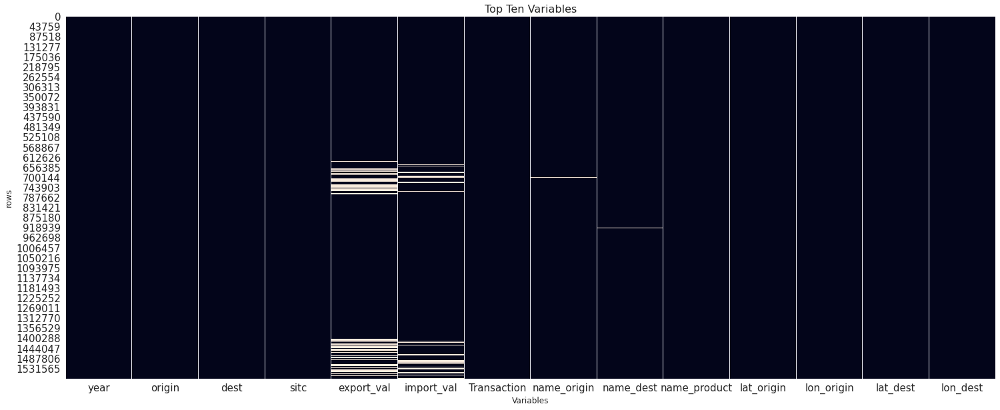

In [97]:
#@title Null Values Sight
sns.set_style('darkgrid')
plt.rcParams.update({'font.size':15})
plt.figure(figsize=(25,10))
sns.heatmap(balance_payments.isnull(), cbar=False)
plt.title("Top Ten Variables")
plt.xlabel('Variables')
plt.ylabel('rows')

*From this graphic we can see in the horizontal axis all the columns from the current status of the dataset, and for the vertical axis the rows, filling it you can see if the table cell is filled or is a missing value, with a black or white line respectively*

*So we can see too few missing values from export and import columns, and origin and destiny name. We will measure them latter*

# Análisis exploratorio (*analytics, data visualization y storytelling* (0-60%)

El análisis exploratorio es parte fundamental para responder las preguntas propuestas por el equipo de data scientists de Platzi. 

* Mantén un código, visualizaciones y storytelling ordenados. 
* Muestra gráficas inline haciendo uso de herramientas como Matplotlib, Seaborn y otras. 
* En el storytelling la narrativa y la visualización deben tener sentido, procura que las gráficas sean visibles, aporten valor a responder las preguntas y sean lo más descriptivas posibles. 
* Además agrega textos que faciliten la narrativa del storytelling.

#### Basic Info

First let's go to explore the basic info about the last seccion results

In [12]:
#@title #####'balance_payments' dataset
balance_payments.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1575308 entries, 0 to 1575307
Data columns (total 14 columns):
 #   Column        Non-Null Count    Dtype  
---  ------        --------------    -----  
 0   year          1575308 non-null  int64  
 1   origin        1575308 non-null  object 
 2   dest          1575308 non-null  object 
 3   sitc          1575308 non-null  int64  
 4   export_val    1447814 non-null  float64
 5   import_val    1475726 non-null  float64
 6   Transaction   1575308 non-null  object 
 7   name_origin   1574258 non-null  object 
 8   name_dest     1571389 non-null  object 
 9   name_product  1575308 non-null  object 
 10  lat_origin    1572816 non-null  float64
 11  lon_origin    1572816 non-null  float64
 12  lat_dest      1572781 non-null  float64
 13  lon_dest      1572781 non-null  float64
dtypes: float64(6), int64(2), object(6)
memory usage: 180.3+ MB


*From the basic info we can see categorical data like type of transaction, name of the origin and destiny country and labels*

*We can see also numerical data, like the import and export value transaction, latitude and longitude and the year*

In [51]:
#@title #####Store the variables by type to use them easily
features = pd.DataFrame(balance_payments.dtypes)
features.columns = ['type']
features_f = features[features['type'] == 'float64'].index
features_o = features[features['type'] == 'object'].index
features_i = features[features['type'] == 'int64'].index

##### Let's go to explore basic description for all kind of data

In [84]:
#@title #####Numerical data
features_num = features_f.append(features_i)
balance_payments.describe().T

,count,mean,std,min,25%,50%,75%,max
year,1575308.0,1.997857e+03,1.417671e+01,1962.000000,1989.000000,2001.000000,2009.000000,2.017000e+03
sitc,1575308.0,6.222229e+03,2.339567e+03,10.000000,5514.000000,6760.000000,7723.000000,9.710000e+03
export_val,1447814.0,1.074322e+06,3.221065e+07,0.000000,0.000000,3308.000000,73794.750000,1.385914e+10
import_val,1475726.0,1.106083e+06,3.493362e+07,0.000000,0.000000,3344.000000,73000.000000,1.580013e+10
lat_origin,1572816.0,1.435434e+01,2.157828e+01,-41.500083,2.889443,2.889443,32.647531,7.761923e+01
lon_origin,1572816.0,-4.255188e+01,5.870840e+01,-176.204224,-73.783892,-73.783892,-3.276575,1.791583e+02
lat_dest,1572781.0,1.470021e+01,2.164618e+01,-41.500083,2.889443,2.889443,35.000074,7.761923e+01
lon_dest,1572781.0,-4.116957e+01,5.965435e+01,-176.204224,-73.783892,-73.783892,1.888334,1.791583e+02


*As it was said the data was given since 1962 to 2017, later we can explore better the money and geographical values*

In [ ]:
#@title #####Categorical data
balance_payments[features_o].describe(include='all').T

,count,unique,top,freq
origin,1575308,245,col,801096
dest,1575308,250,col,777592
Transaction,1575308,2,export,799406
name_origin,1574258,241,Colombia,801096
name_dest,1571389,243,Colombia,777592
name_product,1575308,936,Coffee,6433


*We have five destiny's more than origin countries, two type of transactions and 936 different products*

In [16]:
#@title ##### Null values
Nulos = 100*balance_payments.isnull().sum()/balance_payments.shape[0]
Nulos = pd.DataFrame(Nulos)
Nulos.columns = ['% Null values']
Nulos.sort_values(by='% Null values', ascending=False, inplace=True)
Nulos

,% Null values
export_val,8.093274
import_val,6.321430
name_dest,0.248777
lat_dest,0.160413
lon_dest,0.160413
lat_origin,0.158191
lon_origin,0.158191
name_origin,0.066654
year,0.000000
origin,0.000000


*As we knew from our previous results, there are to few null data, just 8%, 6% and less than zero% for Export and import values and names respectively. This magnitudes doesn't matter in the future analysis*

#### Numerical data

Let's go to watch the distribution of **numerical data**

Text(0.5, 1.0, 'Transaction year')

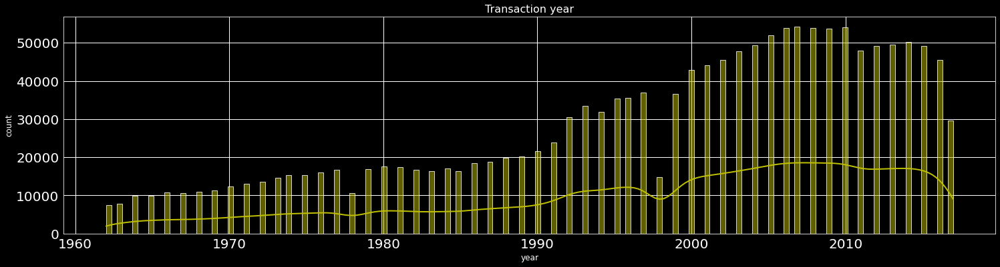

In [87]:
#@title Transaction year histogram
plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,6))
sns.histplot(balance_payments, x='year', color='y', kde=True)
plt.xlabel('year')
plt.ylabel("count")
plt.title('Transaction year')

*As we can see we have more transaction from 2017 than the pder years, so we hope to fine more transaction value about this year*

Text(0.5, 1.0, 'Export Value by year')

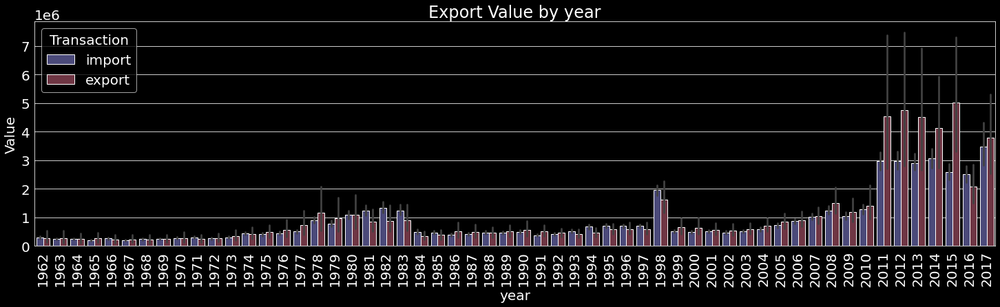

In [13]:
#@title Transaction Export value  by year
plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,6))
sns.barplot(x="year", y="export_val", hue="Transaction", data=balance_payments,palette='icefire')
plt.xticks(rotation=90)
plt.xlabel('year')
plt.ylabel("Value")
plt.title('Export Value by year')

*In this graphic we can see the evolution of the export and import value from all the export records, it tends to be very simmilar and have his highest value on 2015 and the lower values are from Sixties*

*The highest value is from 2015 despite we have more transactions on 2007 as we saw before*

Text(0.5, 1.0, 'Import Value by year')

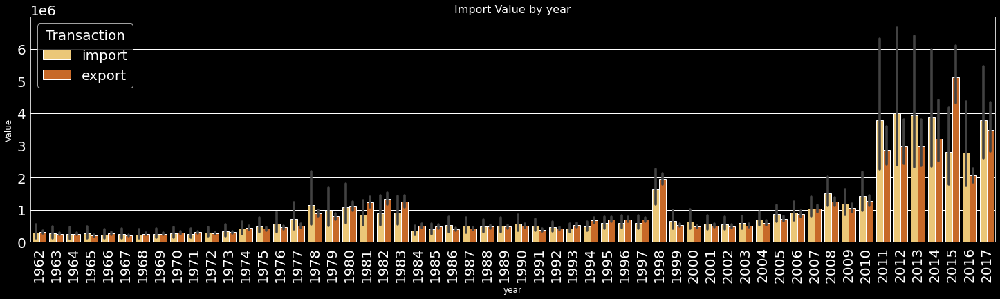

In [95]:
#@title Transaction import value by year
plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,6))
sns.barplot(x="year", y="import_val", hue="Transaction", data=balance_payments,palette='YlOrBr')
plt.xticks(rotation=90)
plt.xlabel('year')
plt.ylabel("Value")
plt.title('Import Value by year')

*In this graphic we can see the evolution of the export and import value from all the export records, it tends to be very simmilar and have his highest value on 2015 and the lower values are from Sixties*

*Is very simmilar to the previous one*

#### Categorical data
Let's go to watch the visualization of the quantity (count) of the **categorical data**

In [98]:
#@title Number of transactions
pd.DataFrame(balance_payments['Transaction'].value_counts())

,Transaction
export,799406
import,775902


[Text(0.5, 1.0, 'Transactions')]

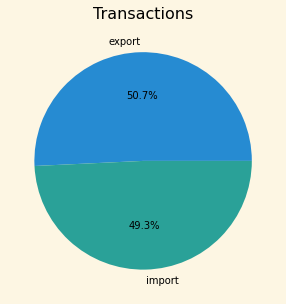

In [49]:
#@title Transaction type participation
plt.style.use("Solarize_Light2")
fig, ax = plt.subplots(1,1,figsize=(15,5))
a = pd.DataFrame(balance_payments['Transaction'].value_counts())
ax.pie(np.array(list(a['Transaction'])),
    labels=np.array(list(a.index)),
    autopct='%1.1f%%',
    shadow=False,
    )
ax.set(title='Transactions')

*There are 0.7% more records from export data*

Text(0.5, 1.0, 'Transation by Product')

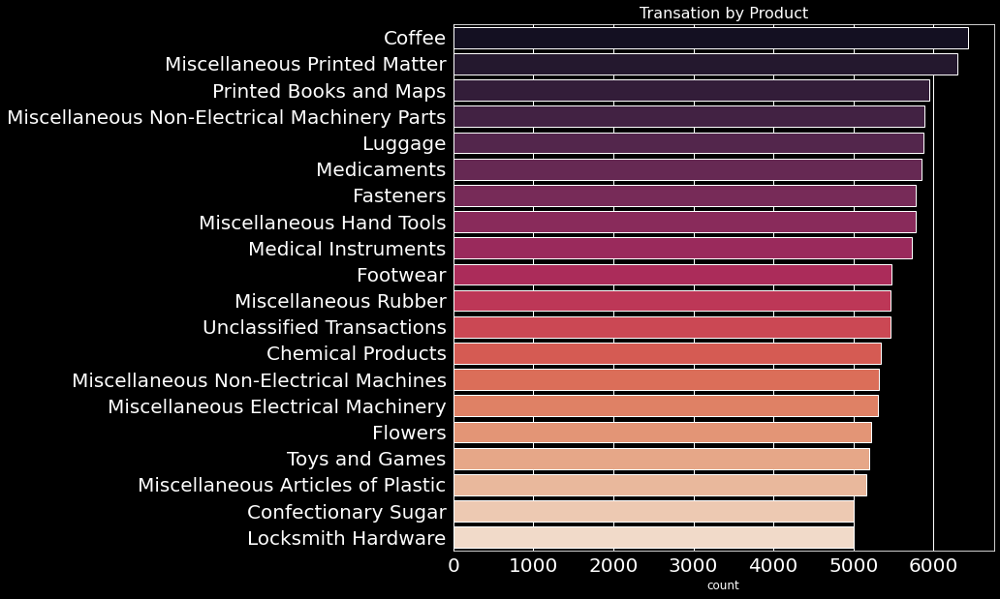

In [75]:
#@title Top 20 Number of transaction of products
plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("dark_background")
var_hist = features_o
plt.figure(figsize=(10,10))
a = pd.DataFrame(balance_payments['name_product'].value_counts()).head(20)
y = np.array(list(a.index))
x = np.array(list(a['name_product']))
sns.barplot(x=x, y=y, palette="rocket")
plt.xlabel("count")
plt.title('Transation by Product')

*The Coffe is the product with more transactions*

Text(0.5, 1.0, 'Origin country')

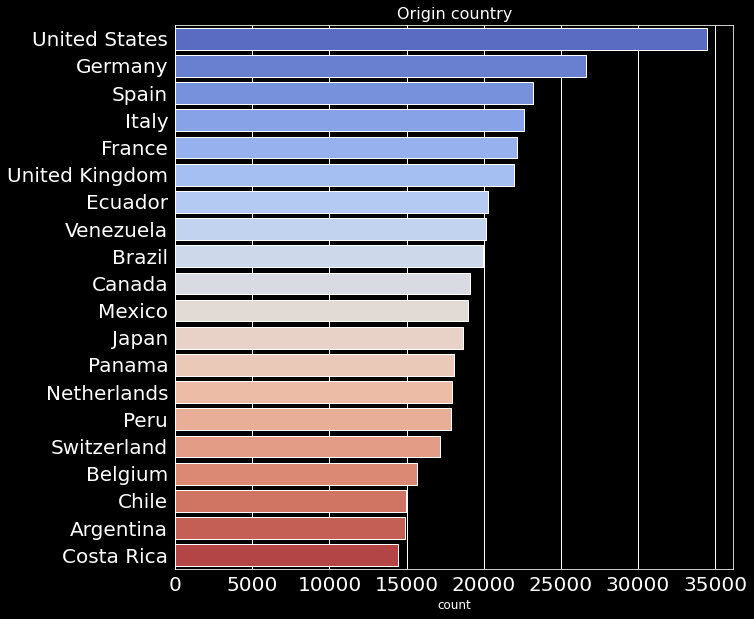

In [76]:
#@title Top 20 Number of transaction of products by country
sns.set_style('darkgrid')
plt.style.use("dark_background")
var_hist = features_o
plt.figure(figsize=(10,10))
a = pd.DataFrame(balance_payments[balance_payments['Transaction'] == 'import']['name_origin'].value_counts()).head(20)
y = np.array(list(a.index))
x = np.array(list(a['name_origin']))
sns.barplot(x=x, y=y, palette="coolwarm")
plt.xlabel("count")
plt.title('Origin country')

Text(0.5, 1.0, 'Destiny country')

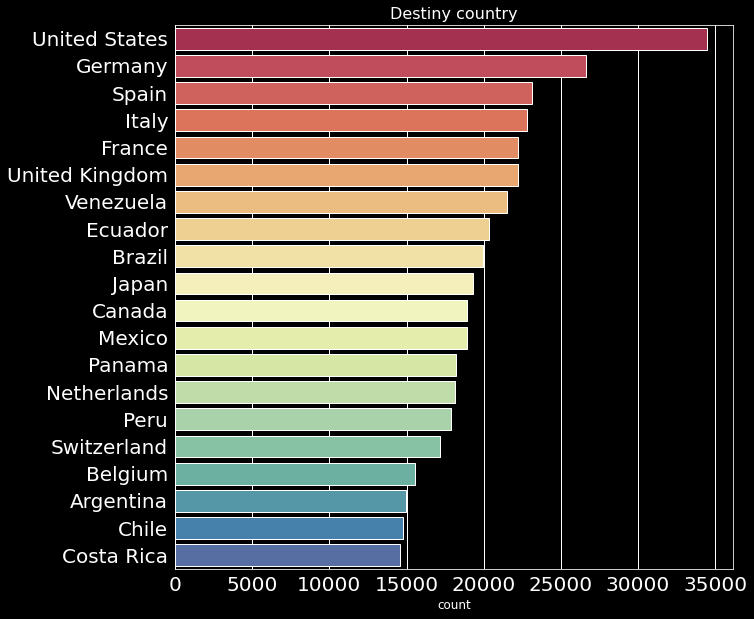

In [78]:
#@title Top 20 Number of transaction of products by country
sns.set_style('darkgrid')
plt.style.use("dark_background")
var_hist = features_o
plt.figure(figsize=(10,10))
a = pd.DataFrame(balance_payments[balance_payments['Transaction'] == 'export']['name_dest'].value_counts()).head(20)
y = np.array(list(a.index))
x = np.array(list(a['name_dest']))
plt.xlabel("count")
sns.barplot(x=x, y=y, palette="Spectral")
plt.title('Destiny country')

*United States and Germany are the countries with more transactions in imports and exports*

#### Colombian Transactions
Now we're going to explore the value of export and import with all the categorical variables but we are going to do this just with the value of Colombian Transactions

In [132]:
#@title Colombian Transactions dataset
tmp = balance_payments[balance_payments['Transaction']=='import'][['year', 'export_val', 'Transaction', 'name_origin', 'name_dest', 'name_product']]
tmp.columns = ['year', 'Value', 'Transaction', 'name_origin', 'name_dest', 'name_product']
colombian_Transactions = balance_payments[balance_payments['Transaction']=='export'][['year', 'export_val', 'Transaction', 'name_origin', 'name_dest', 'name_product']]
colombian_Transactions.columns = ['year', 'Value', 'Transaction', 'name_origin', 'name_dest', 'name_product']
colombian_Transactions = colombian_Transactions.append(tmp)
colombian_Transactions

,year,Value,Transaction,name_origin,name_dest,name_product
775902,1962,0.0,export,Colombia,Cote d'Ivoire,Coffee Extracts
775903,1962,12000.0,export,Colombia,Cote d'Ivoire,Tobacco unmanufactured; tobacco refuse
775904,1962,0.0,export,Colombia,Democratic Republic of the Congo,Planting Seeds and Spores
775905,1962,0.0,export,Colombia,Republic of the Congo,Planting Seeds and Spores
775906,1962,112000.0,export,Colombia,Algeria,Tobacco unmanufactured; tobacco refuse
...,...,...,...,...,...,...
775897,2017,8658.0,import,Uruguay,Colombia,Miscellaneous Articles of Glass
775898,2017,NaN,import,Uruguay,Colombia,Cards and Decals
775899,2017,3816.5,import,Uruguay,Colombia,Miscellaneous Printed Matter
775900,2017,500.0,import,Uruguay,Colombia,Imitation Jewellery


Text(0.5, 1.0, 'Monetary Value participation')

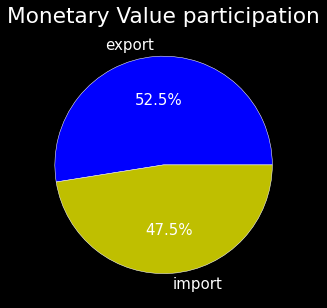

In [135]:
#@title Export and imports Value participation
plt.rcParams.update({'font.size': 15})
plt.style.use("dark_background")
fig, ax = plt.subplots(1,1,figsize=(15,5))
a = colombian_Transactions.groupby(['Transaction']).sum()[['Value']]
ax.pie(np.array(list(a['Value'])),
    labels=np.array(list(a.index)),
    autopct='%1.1f%%',
    shadow=False,
    colors = ['b','y']
    )
plt.title('Monetary Value participation')

*As we can see historically Colombia have more exports than imports, and that is a good balance signal*

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Text(0.5, 1.0, 'Top Product by Import value')

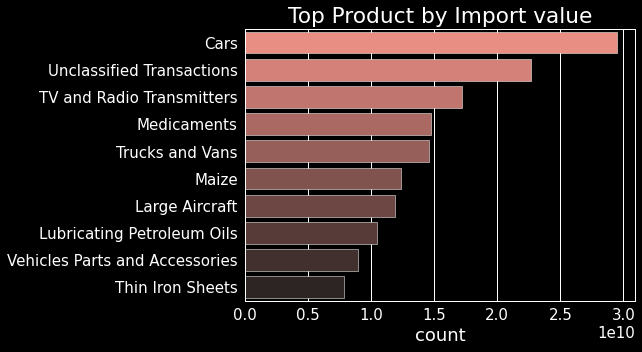

In [141]:
#@title Top 10 products of higher import value
plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(7,5))
a = colombian_Transactions[balance_payments['Transaction']=='import']
a = a.groupby(['name_product']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_import_products = a.index[:10]
y = np.array(list(a.index))
x = np.array(list(a['Value']))
sns.barplot(x=x, y=y, palette="dark:salmon_r")
plt.xlabel("count")
plt.title('Top Product by Import value')


*As we can see historically Colombia imports Cars and many others unclasificated stuffs*

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Text(0.5, 1.0, 'Top Product by Export value')

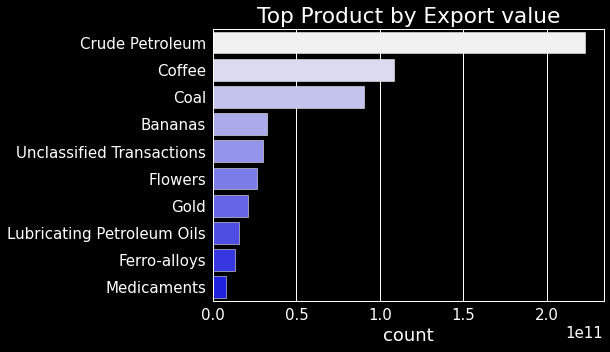

In [143]:
#@title Top 10 products of higher Export value
plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(7,5))
a = colombian_Transactions[balance_payments['Transaction']=='export']
a = a.groupby(['name_product']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_export_products = a.index[:10]
y = np.array(list(a.index))
x = np.array(list(a['Value']))
sns.barplot(x=x, y=y, palette="light:b")
plt.xlabel("count")
plt.title('Top Product by Export value')

*As we can see we have the typical exported products, like Crude Petroleum, Coffe, coal, Bananas and flowers*

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Text(0.5, 1.0, 'Top Countries by Import value')

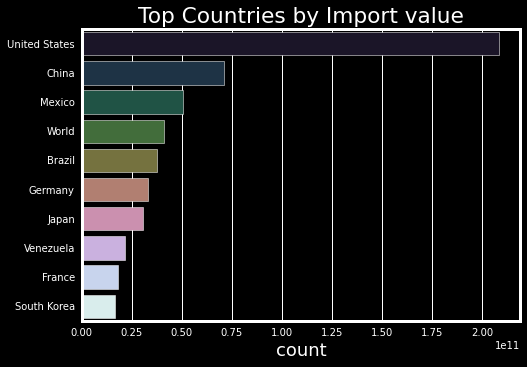

In [195]:
#@title Top 10 Countries of higher import value
plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(7,5))
a = colombian_Transactions[balance_payments['Transaction']=='import']
a = a.groupby(['name_origin']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_import_countries = a.index[:10]
y = np.array(list(a.index))
x = np.array(list(a['Value']))
sns.barplot(x=x, y=y, palette="cubehelix")
plt.xlabel("count")
plt.title('Top Countries by Import value')


*United States, China and Mexico are the countries with the highest Import value along the history*

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Text(0.5, 1.0, 'Top Countries by Export value')

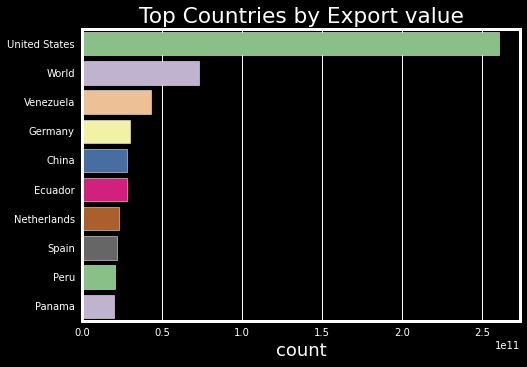

In [194]:
#@title Top 10 Countries of higher Export value
plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(7,5))
a = colombian_Transactions[balance_payments['Transaction']=='export']
a = a.groupby(['name_dest']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_export_countries = a.index[:10]
y = np.array(list(a.index))
x = np.array(list(a['Value']))
sns.barplot(x=x, y=y, palette="Accent")
plt.xlabel("count")
plt.title('Top Countries by Export value')

*United States and Venezuela are the countries with the highest Export value along the history*

#### Geografical data
Let's go to watch the visualization of **geografical data**

In [22]:
#@title #21st Century Exports Destiny
df = balance_payments[balance_payments['Transaction']=='export'] 
df = df[df['year']>2000]
df = df.dropna()
max_amount = float(df['export_val'].max())

folium_hmap = folium.Map(location=[0, 0],
                        zoom_start=3,
                        tiles="OpenStreetMap")

hm_wide = HeatMap( list(zip(df['lat_dest'], df['lon_dest'], df['export_val'])),
                   min_opacity=0.2,
                   max_val=1000,
                   radius=8, blur=6, 
                   max_zoom=15, 
                 )

folium_hmap.add_child(hm_wide)

*We can see where the exports goes all around the world, as more red the point higher the value of the transactions*

In [25]:
#@title #21st Century Import Origins
df = balance_payments[balance_payments['Transaction']=='import'] 
df = df[df['year']>=2000]
df = df.dropna()
max_amount = float(df['import_val'].max())

folium_hmap = folium.Map(location=[0, 0],
                        zoom_start=3,
                        tiles="OpenStreetMap")

hm_wide = HeatMap( list(zip( df['lat_origin'],df['lon_origin'], df['import_val'])),
                   min_opacity=0.2,
                   max_val=1000,
                   radius=8, blur=6, 
                   max_zoom=15, 
                 )

folium_hmap.add_child(hm_wide)

*We can see where the imports comes from all around the world, as more red the point higher the value of the transactions*

#### Evolution

Let's go to see the evolution of the value of top products along the timeline

Text(0.5, 1.0, 'Top 10 Export products evolution')

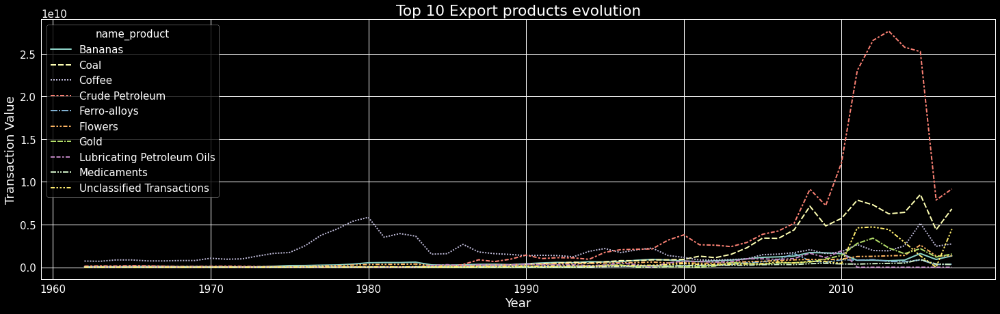

In [156]:
#@title Top 10 Export products evolution
tmp = colombian_Transactions[colombian_Transactions['name_product'].isin(top_ten_export_products)]
tmp = tmp[tmp['Transaction']=='export']
year_product = pd.pivot_table(tmp,index="year", columns="name_product", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Export products evolution')

*We can see how at the eigties the coffee was the best export product, but in the 21st century the crude petroleum and the coal, lead this scenario ahead the Coffee*

Text(0.5, 1.0, 'Top 10 Import products evolution')

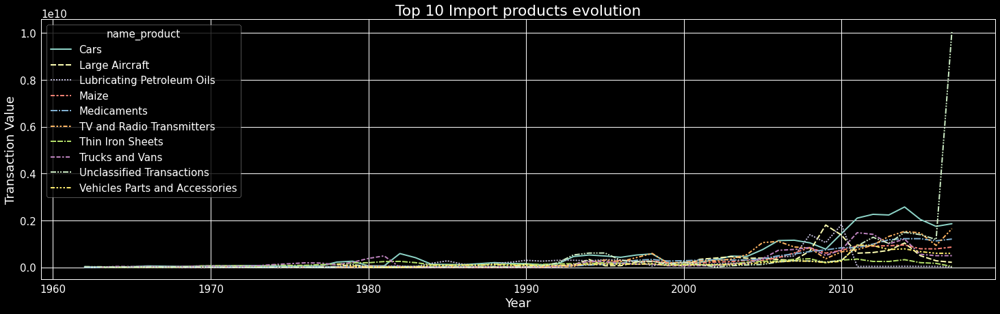

In [157]:
#@title Top 10 Import products evolution
tmp = colombian_Transactions[colombian_Transactions['name_product'].isin(top_ten_import_products)]
tmp = tmp[tmp['Transaction']=='import']
year_product = pd.pivot_table(tmp,index="year", columns="name_product", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Import products evolution')

*We can see that in the last to years appeared a lot of stuffs that doesn't have classification yet, but products like Cars and Large aircrafts have been imported in with a higher value than the other products*

Text(0.5, 1.0, 'Top 10 Export countries evolution')

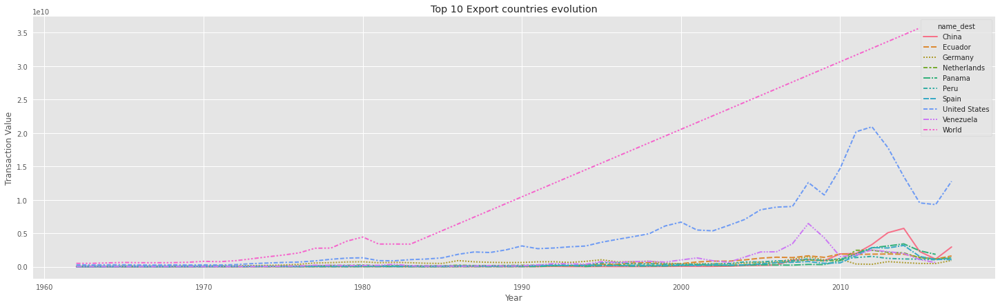

In [167]:
#@title Top 10 Export countries evolution
tmp = colombian_Transactions[colombian_Transactions['name_dest'].isin(top_ten_export_countries)]
tmp = tmp[tmp['Transaction']=='export']
year_product = pd.pivot_table(tmp,index="year", columns="name_dest", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("ggplot")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Export countries evolution')

*We can see how since the eighties the export to the World has been rising like linearly, followed by USA and China in the last 10 years*

Text(0.5, 1.0, 'Top 10 Import countries evolution')

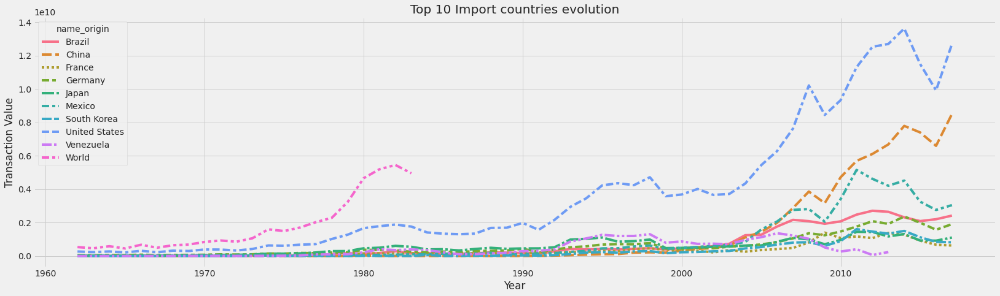

In [169]:
#@title Top 10 Import countries evolution
tmp = colombian_Transactions[colombian_Transactions['name_origin'].isin(top_ten_import_countries)]
tmp = tmp[tmp['Transaction']=='import']
year_product = pd.pivot_table(tmp,index="year", columns="name_origin", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("fivethirtyeight")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Import countries evolution')

*Here we can see that the records of World imports finished in 1983 and how USA is the best exporter for colombia and in the las ten years China and Mexico have been leading the import values to Colombia*

#### Product Country Analysis

*Let's go to see which products from wich countrys have the best impact in Colombia's Trade balance*

In [177]:
colombian_Transactions['name_dest_product'] = colombian_Transactions['name_dest'] + '~' + colombian_Transactions['name_product']
colombian_Transactions['name_origin_product'] = colombian_Transactions['name_origin'] + '~' +colombian_Transactions['name_product']
a = colombian_Transactions[balance_payments['Transaction']=='import']
a = a.groupby(['name_origin_product']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_imports = a.index[:10]
a = colombian_Transactions[balance_payments['Transaction']=='export']
a = a.groupby(['name_dest_product']).sum()[['Value']].sort_values(by='Value', ascending=False).head(10)
top_ten_exports = a.index[:10]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Text(0.5, 1.0, 'Top 10 Exports evolution')

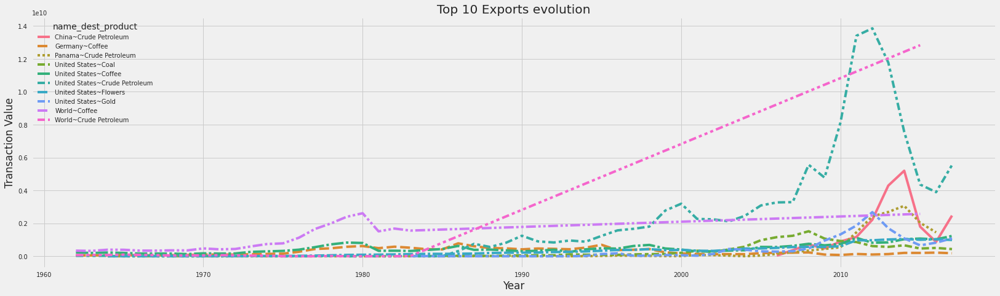

In [187]:
#@title Top 10 Exports Evolution
tmp = colombian_Transactions[colombian_Transactions['name_dest_product'].isin(top_ten_exports)]
tmp = tmp[tmp['Transaction']=='export']
year_product = pd.pivot_table(tmp,index="year", columns="name_dest_product", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("fivethirtyeight")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Exports evolution')

*In this graphic we can see exactly  historically which products we sell to which countries with the highest value transactions, the Crude Petroleum to USA and the world, and coffe to the world*

*In the last ten years we have Crude Petroleum sold to China and Panama and Gold to USA*

Text(0.5, 1.0, 'Top 10 Imports evolution')

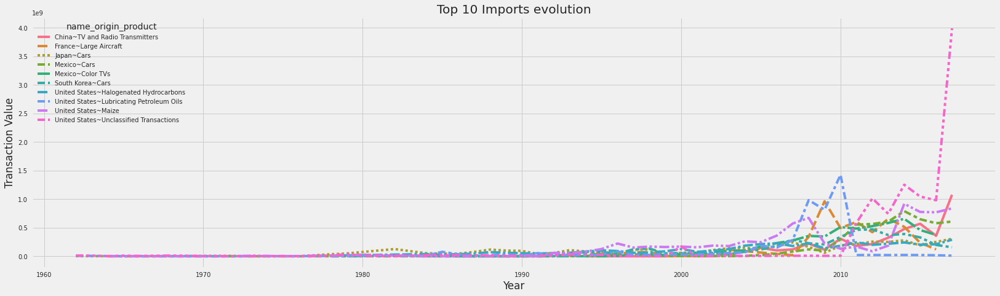

In [186]:
#@title Top 10 Imports evolution
tmp = colombian_Transactions[colombian_Transactions['name_origin_product'].isin(top_ten_imports)]
tmp = tmp[tmp['Transaction']=='import']
year_product = pd.pivot_table(tmp,index="year", columns="name_origin_product", values="Value", aggfunc=sum)

plt.rcParams.update({'font.size': 20})
sns.set_style('darkgrid')
plt.style.use("fivethirtyeight")
plt.figure(figsize=(25,7))
sns.lineplot(data=year_product)
plt.xlabel("Year")
plt.ylabel("Transaction Value")
plt.title('Top 10 Imports evolution')

*The Imports have been so different along the history, we have bought Lubricating Petroleum Oils to United States, Large Aircraft to France, Cars to Mexico and TV and Radio Transmitters to China*

#### The Colombian Trade balance

*The trade balance is the difference that exists between the total exports and imports of a country*

Text(0.5, 1.0, 'Trade Balance Evolution')

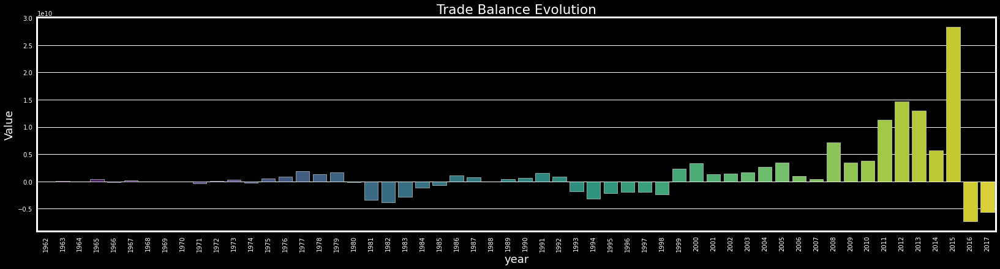

In [220]:
#@title Trade Balance Evolution
t_balance = pd.pivot_table(colombian_Transactions, index='year', columns='Transaction', values = 'Value', aggfunc=sum)
t_balance = pd.DataFrame(t_balance)
t_balance['Trade_balance'] = t_balance['export']-t_balance['import']


plt.rcParams.update({'font.size': 15})
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.figure(figsize=(25,6))
sns.barplot(x=t_balance.index, y="Trade_balance", data=t_balance, palette='viridis')
plt.xticks(rotation=90)
plt.xlabel('year')
plt.ylabel("Value")
plt.title('Trade Balance Evolution')

*From the Trade Balance Evolution grapic, we can see how Colombia has been losing money the last to years of the series, and how Colombia had been had a good performance in the 21st Century despite last to years*

*In the very beggining we can see that the value of the money the time doesn't let us compare properly all the history*

# Modelo (opcional)

Si necesitas agregar un modelo para mejorar tu análisis hazlo en esta sección del notebook. **La evaluación será contada como parte del análisis exploratorio y es completamente opcional**.

- En el desarrollo del modelo se requiere una organización del código y la estructuración del propio modelo. Las celdas que ejecuten entrenamientos o búsqueda de parámetros deben estar con **verbose 0**, esto con el fin de no ensuciar la salida de código y agilizar su revisión.


*I want to predict the value (Value) of a transaction of a given the product, country an year, so let's go to use the same way of the Colombian Tractions data sets, but with numerical data, to solve this*

In [227]:
#@title Numerical data set for training
tmp = balance_payments[balance_payments['Transaction']=='import'][['year', 'sitc', 'import_val', 'Transaction', 'lat_origin', 'lon_origin', 'lat_dest', 'lon_dest']]
tmp.columns = ['year', 'sitc', 'Value', 'Transaction', 'lat_origin', 'lon_origin', 'lat_dest', 'lon_dest']
colombian_Transactions_numerical = balance_payments[balance_payments['Transaction']=='export'][['year', 'sitc', 'export_val', 'Transaction', 'lat_origin', 'lon_origin', 'lat_dest', 'lon_dest']]
colombian_Transactions_numerical.columns = ['year', 'sitc', 'Value', 'Transaction', 'lat_origin', 'lon_origin', 'lat_dest', 'lon_dest']
colombian_Transactions_numerical = colombian_Transactions_numerical.append(tmp)

conditions = [
    (colombian_Transactions_numerical['Transaction'] == 'import'),
    (colombian_Transactions_numerical['Transaction'] == 'export')
]
values = [0,1]
colombian_Transactions_numerical['Transaction'] = np.select(conditions, values)

colombian_Transactions_numerical = colombian_Transactions_numerical.dropna()
colombian_Transactions_numerical

,year,sitc,Value,Transaction,lat_origin,lon_origin,lat_dest,lon_dest
775902,1962,712,0.0,1,2.889443,-73.783892,7.989737,-5.567946
775903,1962,1210,12000.0,1,2.889443,-73.783892,7.989737,-5.567946
775904,1962,2925,0.0,1,2.889443,-73.783892,-2.981434,23.822264
775905,1962,2925,0.0,1,2.889443,-73.783892,-0.726433,15.641915
775906,1962,1210,112000.0,1,2.889443,-73.783892,28.000027,2.999983
...,...,...,...,...,...,...,...,...
775896,2017,6635,26526.5,0,-32.875555,-56.020153,2.889443,-73.783892
775898,2017,8924,4285.5,0,-32.875555,-56.020153,2.889443,-73.783892
775899,2017,8928,25667.5,0,-32.875555,-56.020153,2.889443,-73.783892
775900,2017,8972,5306.0,0,-32.875555,-56.020153,2.889443,-73.783892


*This Data set, will help me to use the historical behave of all transactions and with all numerical data we can run some models to solve this regression problem*

Text(0.5, 1.0, 'Correlación de variables numericas')

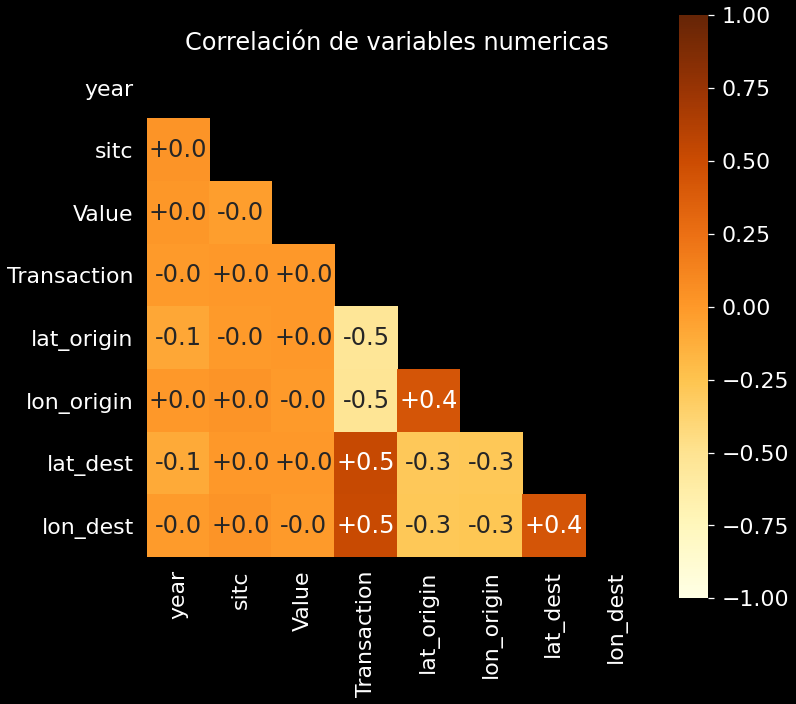

In [231]:
#@title Correlations analysis
#plt.rcParams.update({'font.size': 13})
#compute correlation matrix
df_correlations = colombian_Transactions_numerical.corr()

#mask the upper half for visualization purposes
mask = np.zeros_like(df_correlations, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Draw the heatmap with the mask and correct aspect ratio
sns.set(font_scale=2)
plt.style.use("dark_background")
plt.figure(figsize= (10,10))
sns.heatmap(df_correlations, mask=mask, cmap="YlOrBr",#"RdYlBu", 
    annot=True, square=True,
    vmin=-1, vmax=1,
    fmt="+.1f")
plt.title("Correlación de variables numericas")

*First is elemental to know how the correlation behave between all the variables and we can see how all the variables are well correlated*

#### Linear Regression

*Let go to see how a linear Regression performs with this data and let's to pay attention to the p-value of all the components and the R-Squared or R2 metric*

In [242]:
#@title Setting test/train sets
X = colombian_Transactions_numerical.columns
y = 'Value'
X_train, X_test, y_train, y_test = train_test_split(colombian_Transactions_numerical[X], colombian_Transactions_numerical[y], test_size=0.80)
X_train.shape

(286084, 8)

In [244]:
#@title Setting the formula
formula = '{} ~ {}'.format(y,' + '.join(col for col in X if col != 'Value'))
formula

'Value ~ year + sitc + Transaction + lat_origin + lon_origin + lat_dest + lon_dest'

In [245]:
#@title Runing linear regression
ml = smf.ols(formula, data = X_train).fit()
print(ml.summary())

                            OLS Regression Results                            
Dep. Variable:                  Value   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     26.96
Date:                Tue, 09 Mar 2021   Prob (F-statistic):           2.89e-37
Time:                        04:52:01   Log-Likelihood:            -5.5083e+06
No. Observations:              286084   AIC:                         1.102e+07
Df Residuals:                  286076   BIC:                         1.102e+07
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept   -1.115e+08   1.52e+07     -7.346      

*As we can see the R-squared metrics tell us that we are above the mean model so we can predict this value with a better stronger model, but we can see that the "Transaction" variable is not statistical significant because of his p-value, so we can try our later model witout this variable*

#### PCA

Let's to see what a PCA analysis perfoms with all the variables

In [247]:
Estandar = StandardScaler(with_std=False)
Estandar.fit(colombian_Transactions_numerical)

df_std = Estandar.transform(colombian_Transactions_numerical)
df_std = pd.DataFrame(df_std)

round(df_std.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
0,1430423.0,0.0,13.86,-34.38,-8.38,3.62,10.62,2.062000e+01
1,1430423.0,-0.0,2357.25,-6197.73,-694.73,539.27,1523.27,3.502270e+03
2,1430423.0,-0.0,44608503.87,-1117144.95,-1117144.95,-1116831.95,-1092144.95,1.579901e+10
3,1430423.0,-0.0,0.50,-0.50,-0.50,-0.50,0.50,5.000000e-01
4,1430423.0,-0.0,21.60,-55.90,-11.51,-11.51,17.93,6.322000e+01
5,1430423.0,-0.0,58.22,-132.94,-30.52,-30.52,39.99,2.224200e+02
6,1430423.0,0.0,21.38,-55.69,-11.30,-11.30,16.14,6.343000e+01
7,1430423.0,0.0,57.76,-132.32,-29.90,-29.90,40.60,2.230400e+02


*We first centred all the data it is to all the variable start in cero to be compare*

In [248]:
autovalores, autovectores = np.linalg.eig(df_std.T.dot(df_std))

In [249]:
PCA = pd.DataFrame(columns = ['Variable','Autovalor'])
PCA['Variable'] = colombian_Transactions_numerical.columns
PCA['Autovalor'] = autovalores.real
PCA = PCA.sort_values(by=('Autovalor'), ascending=False, ignore_index = True)
PCA['Participacion'] = PCA['Autovalor']/PCA['Autovalor'].sum()*100
PCA['Acumulado'] = PCA['Participacion'].cumsum()
PCA.head(50)

,Variable,Autovalor,Participacion,Acumulado
0,year,2.846423e+21,1.000000e+02,100.0
1,sitc,7.943518e+12,2.790702e-07,100.0
2,Value,6.403370e+09,2.249620e-10,100.0
3,Transaction,3.520487e+09,1.236811e-10,100.0
4,lat_dest,5.603693e+08,1.968679e-11,100.0
5,lon_origin,4.639822e+08,1.630053e-11,100.0
6,lat_origin,2.598734e+08,9.129821e-12,100.0
7,lon_dest,1.583099e+05,5.561714e-15,100.0


*As a result we have the just the Year have all the variability to predict the serie and sow as that the lattitude and longitude doesn't matter too much in this proccess*

#### Neural Network

Just for curiosity, let's to see what happend if we use this little data set in a neural network to predict the Value of the transaction, knowing that the "Transations" variable is not usefull and the "Year" variable has all the variability

In [265]:
#@title Setting variables
best_variables = ['year',
                 'sitc',
                 'Value',
                 'lat_dest',
                 'lon_origin'
                 ]
df=colombian_Transactions_numerical[best_variables]

In [266]:
#@title Setting Min Max Scaling
Estandar = MinMaxScaler()
Estandar.fit(df)

df_std = Estandar.transform(df)
df_std = pd.DataFrame(df_std)
round(df_std.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
0,1430423.0,0.63,0.25,0.0,0.47,0.69,0.82,1.0
1,1430423.0,0.64,0.24,0.0,0.57,0.69,0.80,1.0
2,1430423.0,0.00,0.00,0.0,0.00,0.00,0.00,1.0
3,1430423.0,0.47,0.18,0.0,0.37,0.37,0.60,1.0
4,1430423.0,0.37,0.16,0.0,0.29,0.29,0.49,1.0


In [268]:
#@title Setting test/train sets
X = [0,1,3,4]
y = [2]
#Entrenamiento y prueba con relación 80:20
X_train, X_test, y_train, y_test = train_test_split(df_std[X],df_std[y], test_size=0.2,random_state=2020)
#Entrenamiento y validación con relación 90:10
X_train, x_val, y_train, y_val = train_test_split(X_train,y_train, test_size=0.1, random_state=2020)

In [269]:
#@title Setting Arquitecture
#Definición de la arquitectura
model = Sequential()
model.add(Dense(8, input_dim=4, kernel_initializer='normal',activation='linear'))
model.add(Dense(4, kernel_initializer='normal',activation='linear'))
model.add(Dense(2, kernel_initializer='normal',activation='linear'))
model.add(Dense(1, kernel_initializer='normal'))

# Compilación del modelo
model.compile(loss='mean_squared_error',
              optimizer='adam',
              metrics=['mean_absolute_percentage_error'])

In [270]:
#@title Model
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 8)                 40        
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 36        
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 10        
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 3         
Total params: 89
Trainable params: 89
Non-trainable params: 0
_________________________________________________________________
None


#### First test

Let's Start with too few epocs and classical batch size

In [271]:
##### Fitting  the model
history = model.fit(X_train, y_train,
                    batch_size=32,
                    epochs=5,
                    validation_data=(x_val,y_val),
                    verbose=0,
                   use_multiprocessing=True)

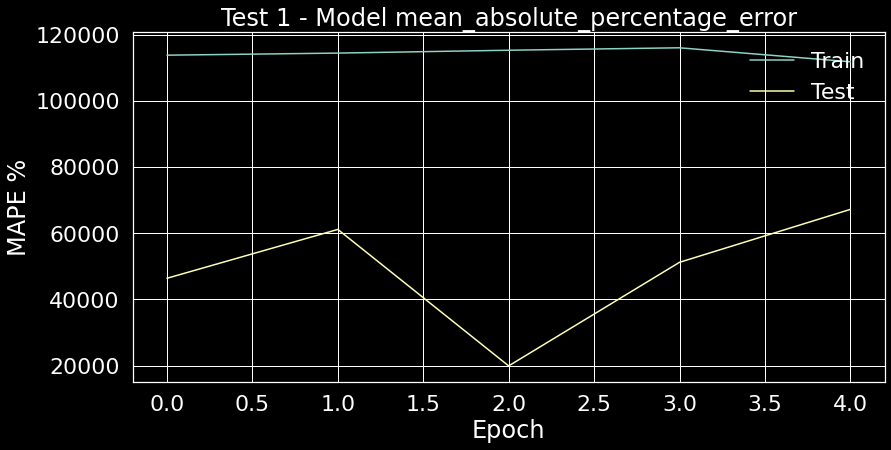

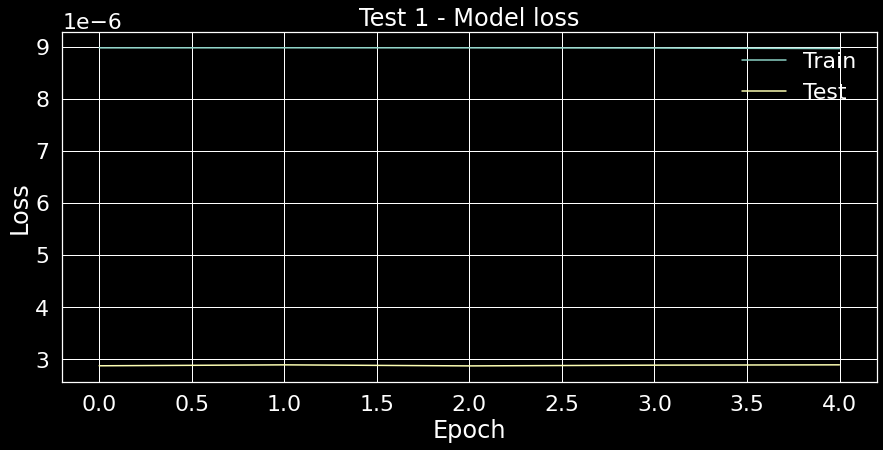

In [275]:
#@title First Training
# Plot training & validation accuracy values
plt.rcParams.update({'font.size': 10})
plt.figure(figsize=(12,6))
plt.style.use("dark_background")
plt.plot(history.history['mean_absolute_percentage_error'])
plt.plot(history.history['val_mean_absolute_percentage_error'])
plt.title('Test 1 - Model mean_absolute_percentage_error')
plt.ylabel('MAPE %')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

# Plot training & validation loss values
plt.rcParams.update({'font.size': 10})
plt.figure(figsize=(13,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Test 1 - Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

In [276]:
results = model.evaluate(X_test, y_test)

for i in range(len(model.metrics_names)):
  print(model.metrics_names[i],": ", results[i])

8941/8941 [==============================] - 8s 845us/step - loss: 7.0024e-06 - mean_absolute_percentage_error: 67348.2891
loss :  7.002386610110989e-06
mean_absolute_percentage_error :  67348.2890625


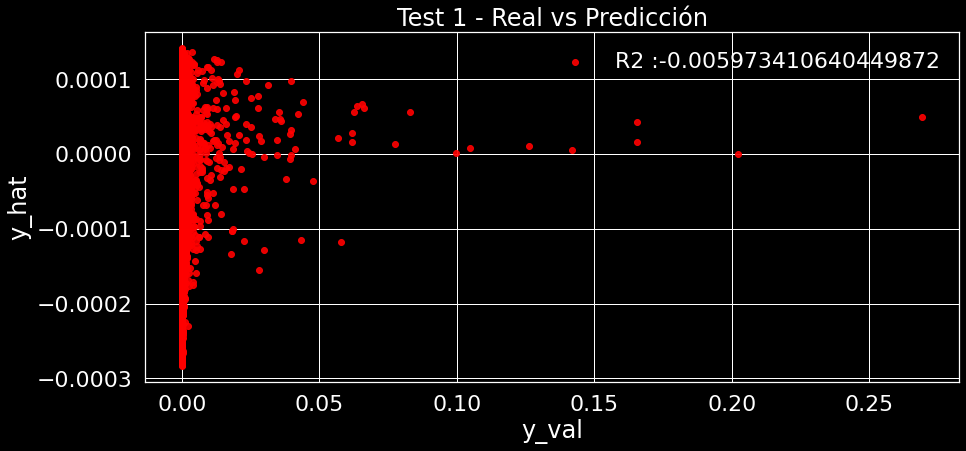

In [278]:
#@title First results
y_hat = model.predict(x_val)
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(13,6))
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.scatter(y= pd.DataFrame(y_hat),
                x=pd.DataFrame(y_val),
           color = 'red',
           alpha=0.9)
plt.title('Test 1 - Real vs Predicción')
plt.xlabel('y_val')
plt.ylabel('y_hat')
plt.legend(['R2 :{}'.format(str(r2_score(pd.DataFrame(y_val),
                                pd.DataFrame(y_hat))))],
           loc='upper right',
           )
plt.show()

*For this first try we can see that a mean model is better, so we have to train a more complex model*

#### Second test

Let's Start the second try this time with 50 epocs

In [279]:

history = model.fit(X_train, y_train,
                    batch_size=32,
                    epochs=50,
                    validation_data=(x_val,y_val),
                    verbose=0,
                   use_multiprocessing=True)

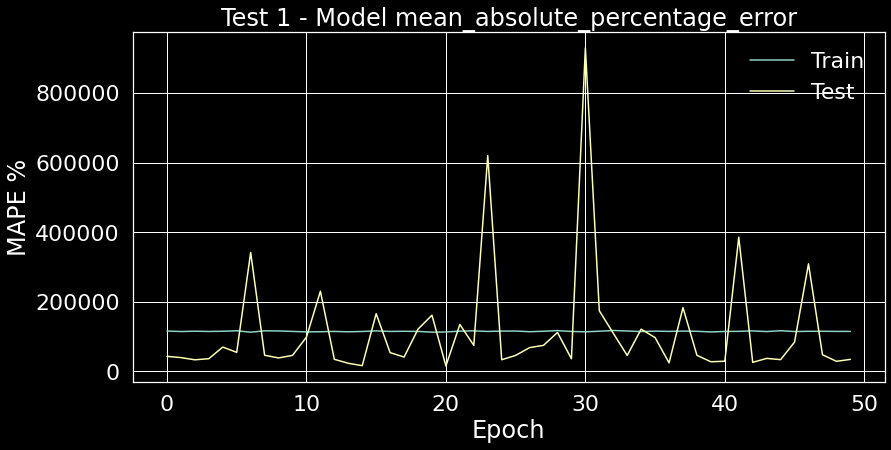

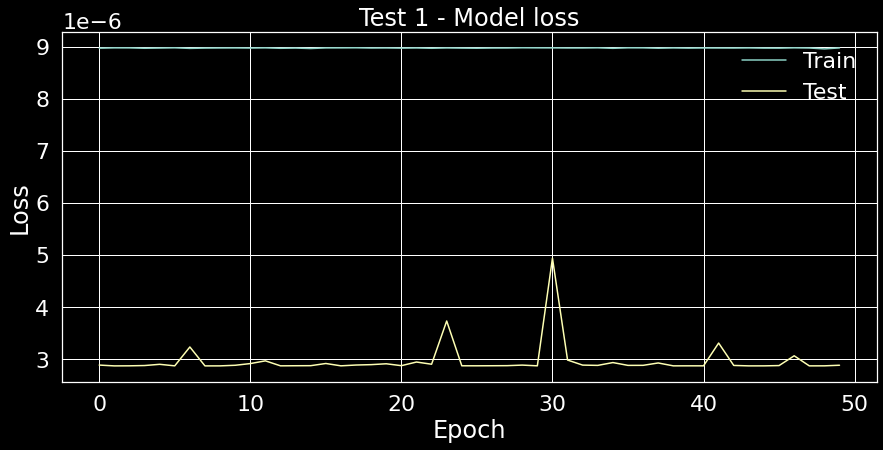

In [280]:
#@title Second Training
# Plot training & validation accuracy values
plt.rcParams.update({'font.size': 10})
plt.figure(figsize=(12,6))
plt.style.use("dark_background")
plt.plot(history.history['mean_absolute_percentage_error'])
plt.plot(history.history['val_mean_absolute_percentage_error'])
plt.title('Test 1 - Model mean_absolute_percentage_error')
plt.ylabel('MAPE %')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

# Plot training & validation loss values
plt.rcParams.update({'font.size': 10})
plt.figure(figsize=(13,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Test 1 - Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

In [281]:
results = model.evaluate(X_test, y_test)

for i in range(len(model.metrics_names)):
  print(model.metrics_names[i],": ", results[i])

8941/8941 [==============================] - 7s 740us/step - loss: 6.9915e-06 - mean_absolute_percentage_error: 34551.4258
loss :  6.991492682573153e-06
mean_absolute_percentage_error :  34551.42578125


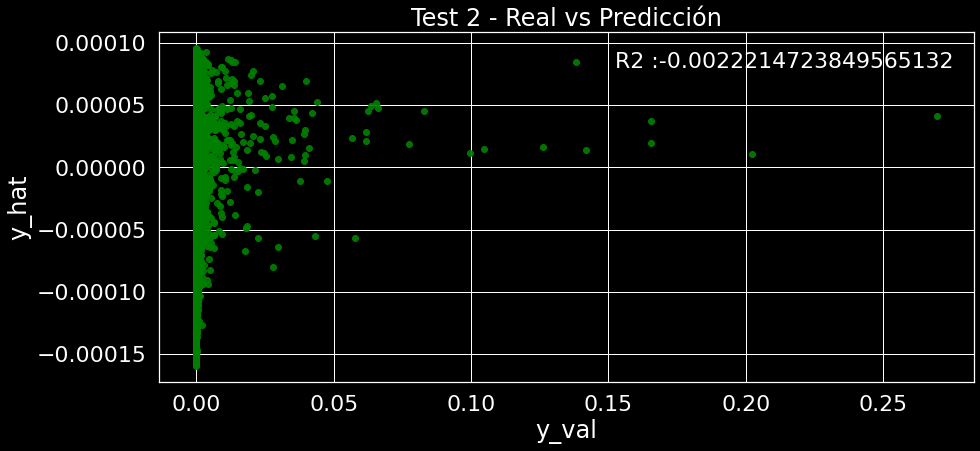

In [283]:
#@title Second results
y_hat = model.predict(x_val)
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(13,6))
sns.set_style('darkgrid')
plt.style.use("dark_background")
plt.scatter(y= pd.DataFrame(y_hat),
                x=pd.DataFrame(y_val),
           color = 'green',
           alpha=0.9)
plt.title('Test 2 - Real vs Predicción')
plt.xlabel('y_val')
plt.ylabel('y_hat')
plt.legend(['R2 :{}'.format(str(r2_score(pd.DataFrame(y_val),
                                pd.DataFrame(y_hat))))],
           loc='upper right',
           )
plt.show()

### *If you are reading this last message Thanks a lot! I enjoyed this triathlon a lot!*